<a href="https://colab.research.google.com/github/dianasargsyan/Number-Plate-Recognition-in-Armenia/blob/main/Detection%26Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd drive/MyDrive/yolov7/

Mounted at /content/drive
/content/drive/MyDrive/yolov7


In [ ]:
!pip install -r requirements.txt
!pip install -r requirements_gpu.txt
!pip install opencv-python
!pip install easyocr
!pip install Levenshtein
!pip install opencv-python-headless

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 344.6/344.6 kB 38.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  error: subprocess-exited-with-error
  
  × Building wheel for pycairo (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for pycairo
Failed to build pycairo
ERROR: Could not build wheels for pycairo, which is required to install pyproject.toml-based projects
Looking in indexes: https://download.pytorch.org/whl/cu113
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 GB 1.1 MB/s eta 0:00:00
     ━━

In [ ]:
import cv2
import re
import Levenshtein
from google.colab.patches import cv2_imshow
import numpy as np
import os
import matplotlib.pyplot as plt
from PIL import Image
import easyocr
import multiprocessing
import time

# Training YOLOv7

In [ ]:
!python train.py --workers 1 --device 0 --batch-size 16 --epochs 100 --img 640 640 --hyp data/hyp.scratch.custom.yaml --name yolov7-custom5 --weights yolov7.pt

2023-04-26 16:03:57.404492: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-26 16:03:58.443319: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
YOLOR 🚀 v0.1-122-g3b41c2c torch 2.0.0+cu118 CUDA:0 (Tesla T4, 15101.8125MB)

Namespace(weights='yolov7.pt', cfg='', data='data/coco.yaml', hyp='data/hyp.scratch.custom.yaml', epochs=100, batch_size=16, img_size=[640, 640], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket='', cache_images=False, image_weights=False, device='0', multi_scale=False, single_cls=False, adam=False, sync_bn=False, local_rank=-1, workers=1, project='runs/train', entity=None, name='yolov7-custom5', exist_ok=False, quad=False, linea

# Results Based on Training

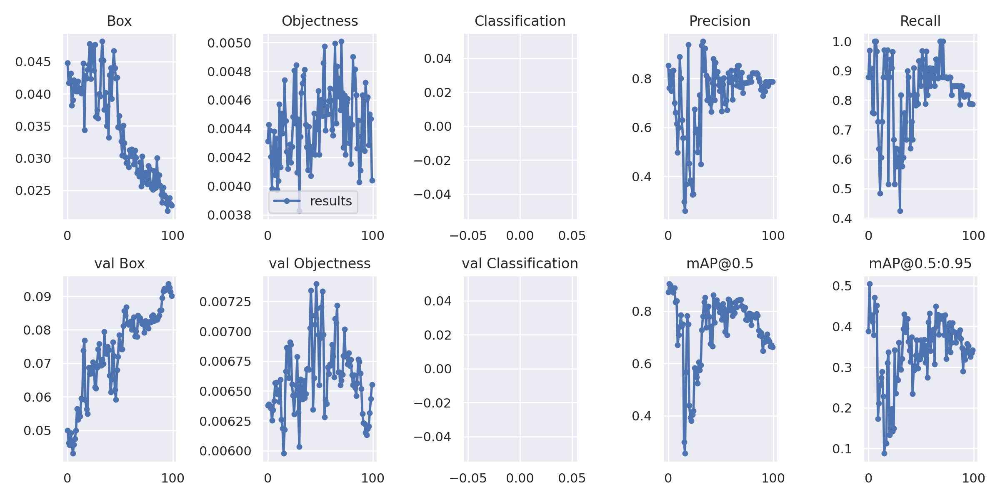

In [ ]:
results = cv2.imread("/content/drive/MyDrive/yolov7/runs/train/yolov7-custom3/results.png")
cv2_imshow(results)

# Results on Test Batch

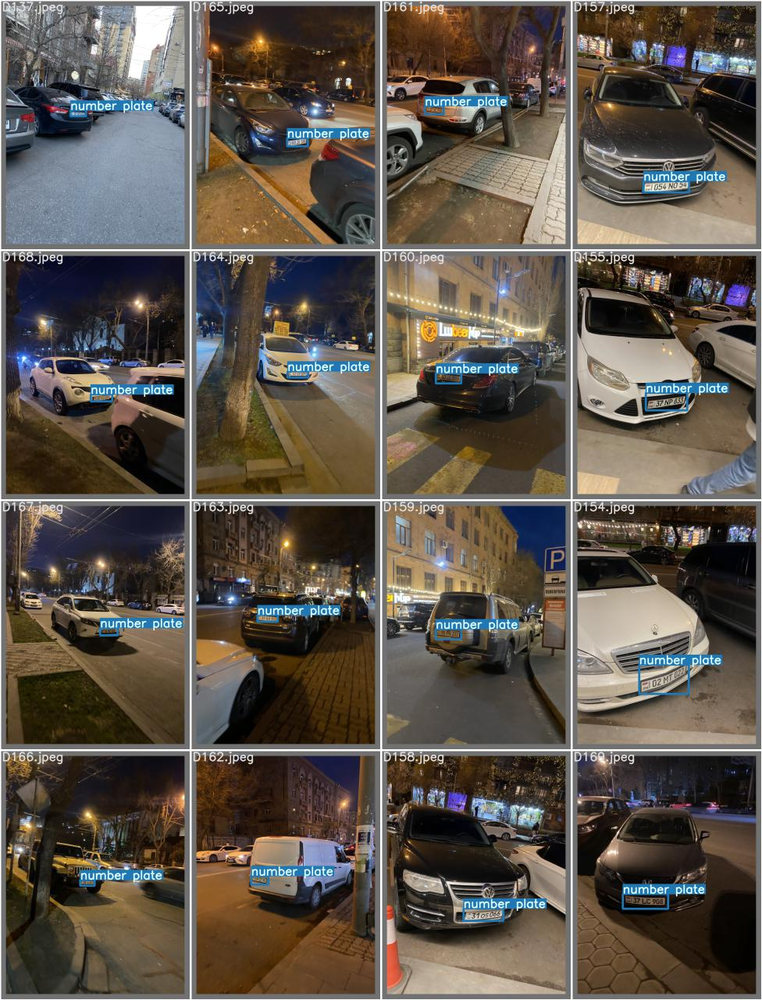

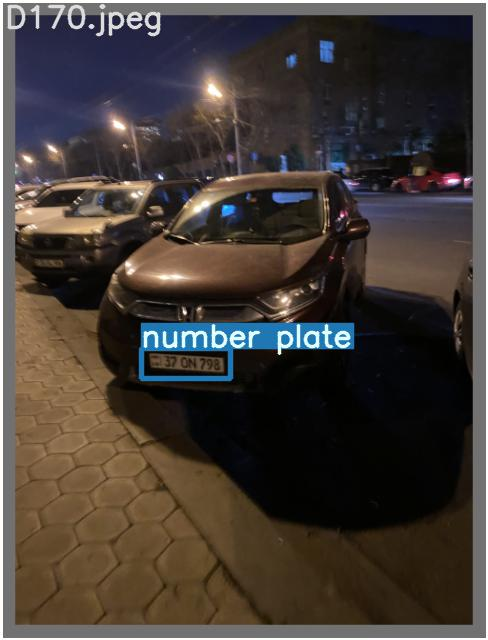

In [ ]:
testbatch = cv2.imread(
    "/content/drive/MyDrive/yolov7/runs/train/yolov7-custom3/test_batch0_labels.jpg")
cv2_imshow(testbatch)
testbatch2 = cv2.imread(
    "/content/drive/MyDrive/yolov7/runs/train/yolov7-custom3/test_batch1_labels.jpg")
cv2_imshow(testbatch2)

# Testing to see how well the trained model detects

In [ ]:
# Adding --save-txt to get the coordinates of the detected bounding box
!python detect.py --weights /content/drive/MyDrive/yolov7/best.pt --source /content/drive/MyDrive/yolov7/data/images/D1.jpeg --save-txt

Namespace(weights=['/content/drive/MyDrive/yolov7/best.pt'], source='/content/drive/MyDrive/yolov7/data/images/D1.jpeg', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=True, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-122-g3b41c2c torch 2.0.0+cu118 CUDA:0 (Tesla T4, 15101.8125MB)

Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
IDetect.fuse
Model Summary: 314 layers, 36481772 parameters, 6194944 gradients
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: i

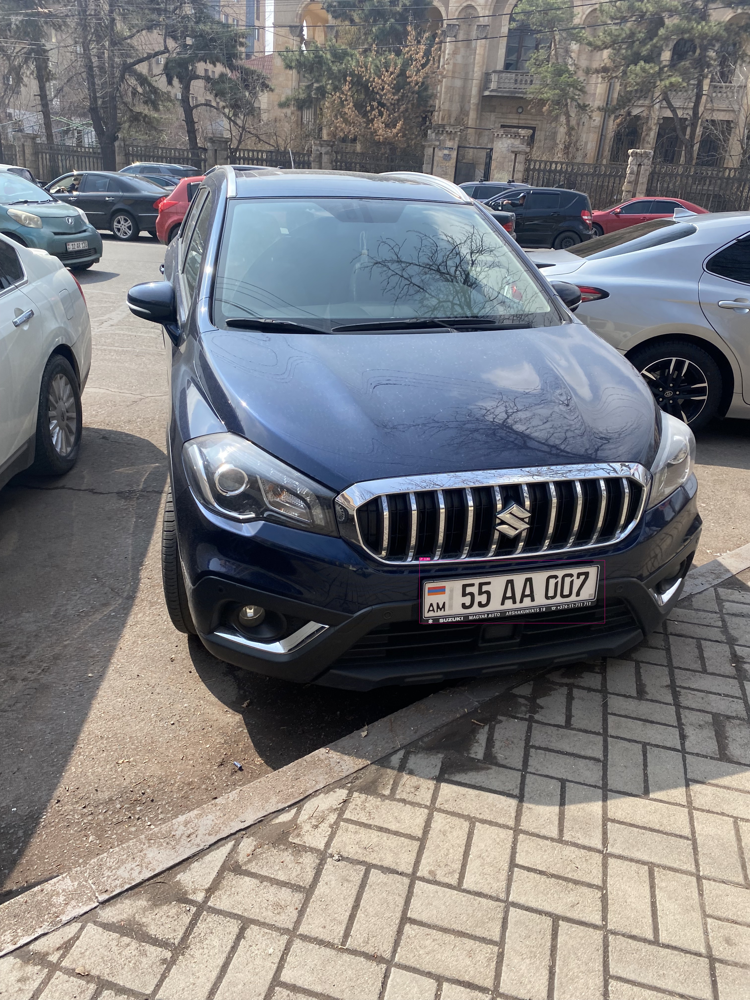

In [ ]:
from PIL import Image
Image.open('runs/detect/exp54/D1.jpeg')

# Recognizing the license plate number

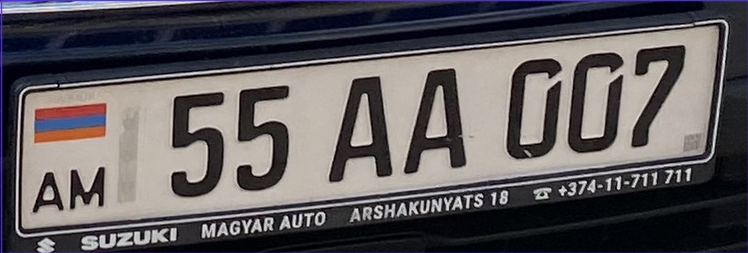

In [ ]:
# Load image
img_path = 'runs/detect/exp52/D1.jpeg'
img = cv2.imread(img_path)

# Load coordinates from text file
txt_path = 'runs/detect/exp52/labels/D1.txt'
with open(txt_path, 'r') as f:
    line = f.readline().strip().split()
    cls, x, y, w, h = [float(x) for x in line]

# Get image dimensions
height, width, _ = img.shape

# Convert bounding box coordinates from relative to absolute
x1 = int((x - w / 2) * width)
y1 = int((y - h / 2) * height)
x2 = int((x + w / 2) * width)
y2 = int((y + h / 2) * height)

# Crop image using the bounding box coordinates
cropped_img = img[y1:y2, x1:x2]

# Show cropped image
cv2_imshow(cropped_img)

Original Image


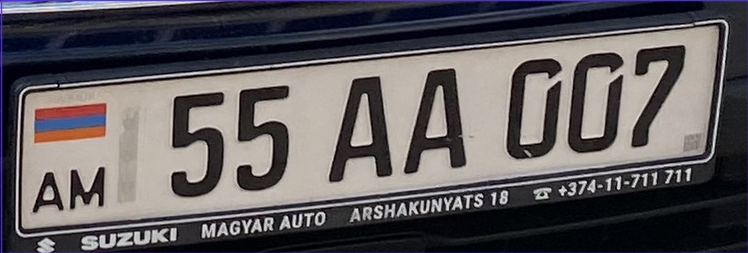

Detected Lines


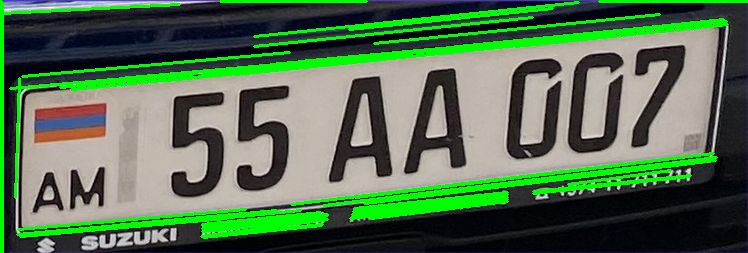

Rotated Image


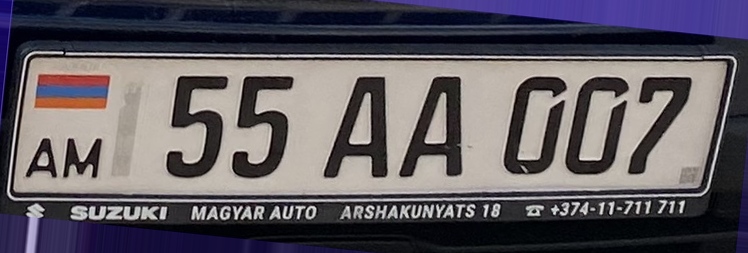

In [ ]:
img = cropped_img

# Convert the image to grayscale
gray = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)

# Apply Canny edge detection
edges = cv2.Canny(gray, 100, 200)

# Apply Hough Line Transform
lines = cv2.HoughLinesP(
    edges,
    rho=1,
    theta=np.pi / 180,
    threshold=100,
    minLineLength=100,
    maxLineGap=10)

# Draw the detected lines on a copy of the original image
line_img = img.copy()
angles = []
for line in lines:
    x1, y1, x2, y2 = line[0]
    cv2.line(line_img, (x1, y1), (x2, y2), (0, 255, 0), 2)
    # Find the angle of the dominant line
    angle = np.arctan2(y2 - y1, x2 - x1) * 180 / np.pi
    angles.append(angle)

dominant_angle = np.median(angles)

# Rotate the image to correct the orientation
h, w = img.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, dominant_angle, 1.0)
rotated_img = cv2.warpAffine(
    img, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)

# Display the results
print("Original Image")
cv2_imshow(cropped_img)
print("Detected Lines")
cv2_imshow(line_img)
print("Rotated Image")
cv2_imshow(rotated_img)
# cv2.waitKey(0)

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete['AM', '55 AA 007']
Country Code: AM
License Plate Number:  55 AA 007
Original Image


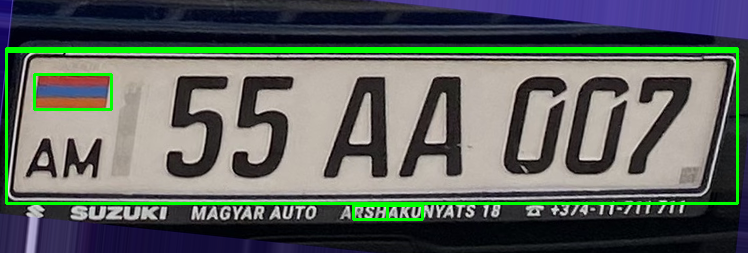

Grayscale Image


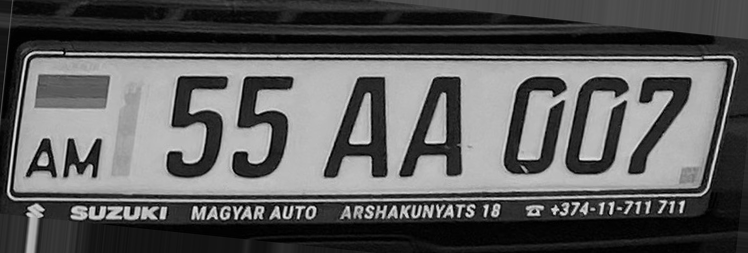

Blurred Image


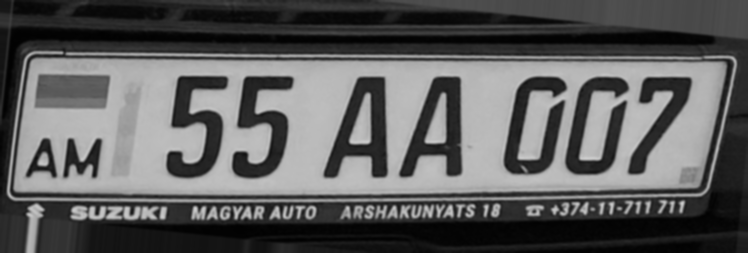

Edges Image


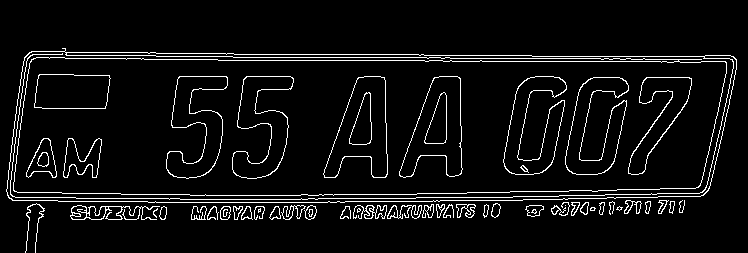

Contours Image


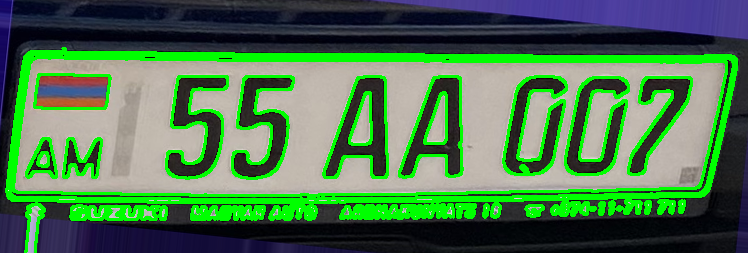

In [ ]:
# Load the license plate image
img = rotated_img

# Convert the image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Apply a Gaussian blur to the grayscale image
blur = cv2.GaussianBlur(gray, (5, 5), 0)

# Apply Canny edge detection to the blurred image
edges = cv2.Canny(blur, 50, 200)

# Find contours in the edges image
contours, _ = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
img_with_contours = img.copy()

# Draw the contours on the image
contours_img = cv2.drawContours(img_with_contours, contours, -1, (0, 255, 0), 2)

# Display the image with contours

for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    aspect_ratio = w / h
    
    # Check if the contour has the aspect ratio of a license plate
    if aspect_ratio > 2 and aspect_ratio < 5:
        cv2.rectangle(rotated_img, (x, y), (x+w, y+h), (0, 255, 0), 2)
        plate_img = rotated_img[y:y+h, x:x+w]

# Use Easy OCR to recognize the license plate number
# Set language to English or any other language you want to recognize
reader = easyocr.Reader(['en'])

result = reader.readtext(plate_img)
result2 = reader.readtext(plate_img, detail = 0)
print(result2)
countrycode = result[0][1]
plate_text = result[1][1]

print("Country Code:", countrycode)
print("License Plate Number: ", plate_text)

# Show the images
print('Original Image')
cv2_imshow(img)
print('Grayscale Image')
cv2_imshow(gray)
print('Blurred Image')
cv2_imshow(blur)
print('Edges Image')
cv2_imshow(edges)
print('Contours Image')
cv2_imshow(contours_img)


# Results of Recognition

0.685185 0.590154 0.231481 0.052331


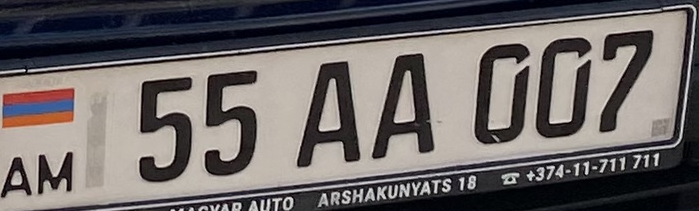

0.581515 0.43378 0.137897 0.031746


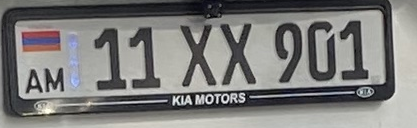

0.590608 0.499876 0.130291 0.029018


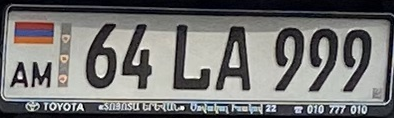

0.277282 0.457961 0.20205 0.06622


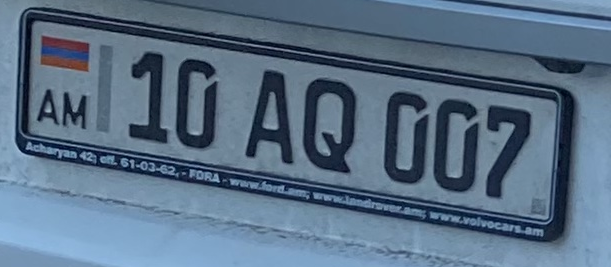

0.568618 0.496404 0.112103 0.022073


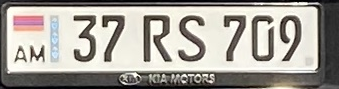

0.562996 0.519965 0.112103 0.022073


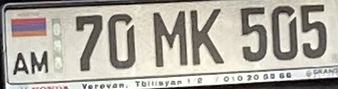

0.510747 0.696305 0.3125 0.063244


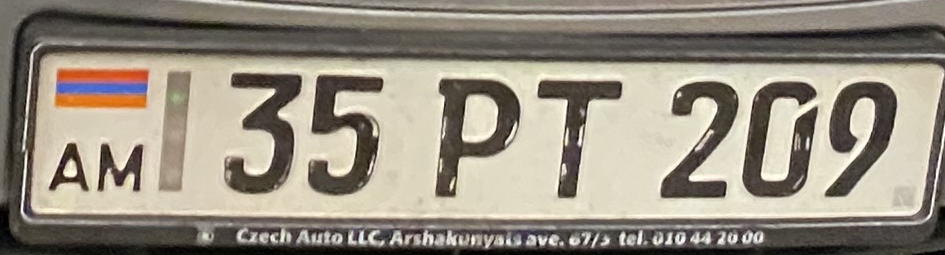

0.432705 0.4344 0.093585 0.022073


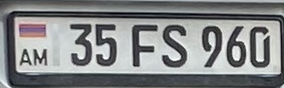

0.331515 0.484747 0.178241 0.045387


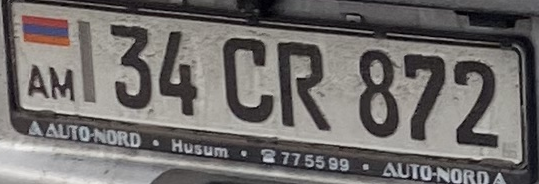

0.28836 0.479911 0.13955 0.035714


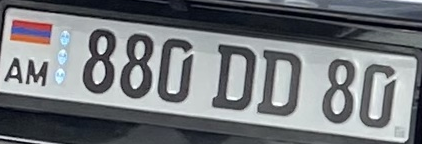

0.284722 0.495784 0.13955 0.037202


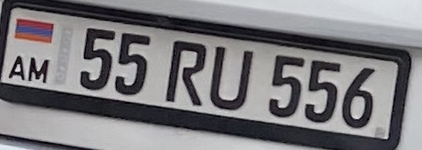

0.411541 0.53373 0.168981 0.044147


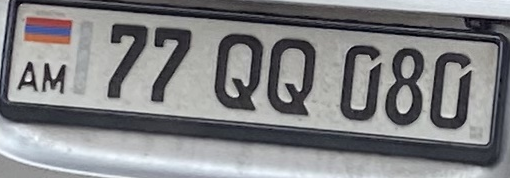

0.262731 0.508929 0.150463 0.03869


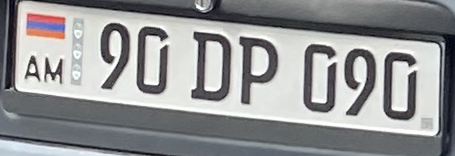

0.2333 0.504836 0.110119 0.022073


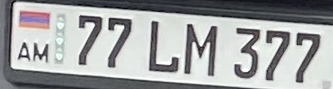

0.317791 0.470238 0.146825 0.044147


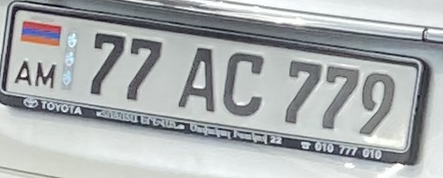

0.427083 0.500496 0.112103 0.024802


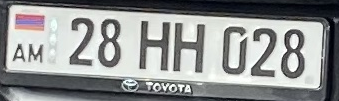

0.340774 0.488839 0.123347 0.031746


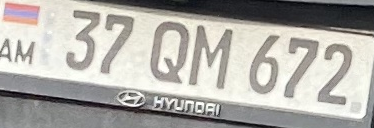

0.528274 0.55506 0.145172 0.023313


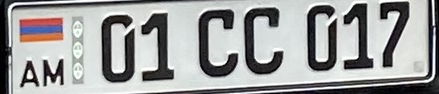

0.338955 0.414559 0.141534 0.039931


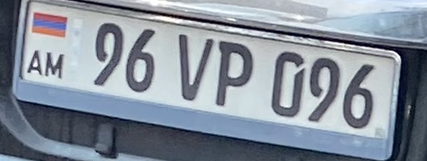

0.423446 0.470982 0.079034 0.017857


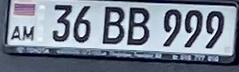

0.5925 0.325625 0.18 0.03375


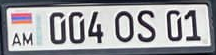

0.395 0.359687 0.316667 0.069375


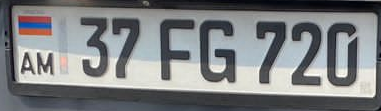

0.425 0.300625 0.267778 0.04875


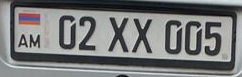

0.50248 0.517857 0.119378 0.023313


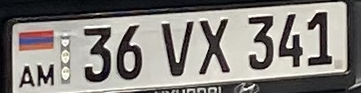

In [ ]:
# Load coordinates from text file
img_dir = '/content/drive/MyDrive/recognizedata'
txt_dir = '/content/drive/MyDrive/labeldata'

# get a list of all image files in the directory
img_files = sorted([os.path.join(img_dir, f)
                   for f in os.listdir(img_dir) if f.endswith('.jpeg')])

# get a list of all txt files in the directory
txt_files = sorted([os.path.join(txt_dir, f)
                   for f in os.listdir(txt_dir) if f.endswith('.txt')])

save_path = '/content/drive/MyDrive/croppedimgs/'

# iterate over the image and txt files simultaneously
for i, j in zip(img_files, txt_files):
    img = cv2.imread(i)

    with open(j, 'r') as f:
        line = f.readline().strip().split()
        cls, x, y, w, h = [float(x) for x in line]
        print(x, y, w, h)
    # Get image dimensions
    height, width, _ = img.shape

    # Convert bounding box coordinates from relative to absolute
    x1 = int((x - w / 2) * width)
    y1 = int((y - h / 2) * height)
    x2 = int((x + w / 2) * width)
    y2 = int((y + h / 2) * height)

    # Crop image using the bounding box coordinates
    cropped_img = img[y1:y2, x1:x2]
    image_name, _ = os.path.splitext(i)

    # Show cropped image
    cv2_imshow(cropped_img)

    result_img_path = os.path.join(save_path, image_name + '_result.jpg')
    cv2.imwrite(result_img_path, cropped_img)

In [ ]:
crpimg_dir = '/content/drive/MyDrive/croppedimgs'
crpimg_files = sorted([os.path.join(crpimg_dir, f)
                      for f in os.listdir(crpimg_dir) if f.endswith('.jpg')])

ground_truth_data = {
    'D1_result.jpg': '55AA007',
    'D9_result.jpg': '36VX341',
    'D10_result.jpg': '11XX901',
    'D11_result.jpg': '64LA999',
    'D113_result.jpg': '37RS709',
    'D15_result.jpg': '70MK505',
    'D18_result.jpg': '35FS960',
    'D23_result.jpg': '34CR872',
    'D24_result.jpg': '880DD80',
    'D26_result.jpg': '55RU556',
    'D27_result.jpg': '77QQ080',
    'D28_result.jpg': '90DP090',
    'D31_result.jpg': '77LM377',
    'D32_result.jpg': '77AC779',
    'D40_result.jpg': '28HH028',
    'D41_result.jpg': '37QM672',
    'D53_result.jpg': '01CC017',
    'D63_result.jpg': '96VP096',
    'D68_result.jpg': '36BB999',
    'D77_result.jpg': '004OS01',
    'D79_result.jpg': '37FG720',
    'D87_result.jpg': '02XX005',
    'D118_result.jpg': '10AQ007',
    'D151_result.jpg': '35PT209',

}

# Recognized license plate dataset
recognized_data = {}
for i in crpimg_files:

    image_name = os.path.basename(i)
    img = cv2.imread(i)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply Canny edge detection
    edges = cv2.Canny(gray, 100, 200)

    # Apply Hough Line Transform
    lines = cv2.HoughLinesP(
        edges,
        rho=1,
        theta=np.pi / 180,
        threshold=100,
        minLineLength=100,
        maxLineGap=10)
    if lines is not None:
        # Draw the detected lines on a copy of the original image
        line_img = np.zeros_like(img)
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(line_img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Find the angle of the dominant line
        angles = []
        for line in lines:
            x1, y1, x2, y2 = line[0]
            angle = np.arctan2(y2 - y1, x2 - x1) * 180 / np.pi
            angles.append(angle)

        dominant_angle = np.median(angles)

        # Rotate the image to correct the orientation
        h, w = img.shape[:2]
        center = (w // 2, h // 2)
        M = cv2.getRotationMatrix2D(center, dominant_angle, 1.0)
        rotated_img = cv2.warpAffine(
            img, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)

        # Convert the image to grayscale
        gray = cv2.cvtColor(rotated_img, cv2.COLOR_BGR2GRAY)

        # Apply a Gaussian blur to the grayscale image
        blur = cv2.GaussianBlur(gray, (5, 5), 0)

        # Apply Canny edge detection to the blurred image
        edges = cv2.Canny(blur, 50, 200)

        # Apply adaptive thresholding to create a binary image
        # thresh
        preprocessed_plate = cv2.adaptiveThreshold(
            gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

        # Find contours in the edges image
        contours, _ = cv2.findContours(
            edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

        # Find the contour with the largest area
        #largest_contour = max(contours, key=cv2.contourArea)
      
        for contour in contours:
            x, y, w, h = cv2.boundingRect(contour)
            aspect_ratio = w / h
            
            # Check if the contour has the aspect ratio of a license plate
            if aspect_ratio > 2 and aspect_ratio < 5:
                cv2.rectangle(rotated_img, (x, y), (x+w, y+h), (0, 255, 0), 2)
                plate_img = rotated_img[y:y+h, x:x+w]

        # Use Easy OCR to recognize the license plate number
        # Set language to English or any other language you want to recognize
        reader = easyocr.Reader(['en'])
        result = reader.readtext(plate_img)
        if len(result) > 1:
            if len(result[0]) > 1:
                countrycode = result[0][1]
                plate_text = result[1][1].replace(" ", "")
                recognized_data[image_name] = plate_text
            if len(result[1]) > 1:
                plate_text = result[1][1].replace(" ", "")
                recognized_data[image_name] = plate_text

        elif len(result) == 1:
            plate_text = result[0][1].replace(" ", "")
            recognized_data[image_name] = plate_text

        else:
            recognized_data[image_name] = "Results list is empty or does not contain enough elements"

    else:
        recognized_data[image_name] = "No lines detected in the image."



In [ ]:
total_chars = 0
total_correct = 0
total_distance = 0
total_images = len(ground_truth_data)
for image_name, gt_text in ground_truth_data.items():
    # Check if recognized plate exists for this image
    if image_name in recognized_data:
        # Get recognized text and remove spaces
        rec_text = recognized_data[image_name].replace(" ", "")
        
        # Calculate Levenshtein distance and update total distance
        distance = Levenshtein.distance(gt_text, rec_text)
        total_distance += distance
  
        # Loop through each character in ground truth text
        num_correct = 0
        for i, char in enumerate(gt_text):
            if i >= len(rec_text):
                break
            if char == rec_text[i]:
                num_correct += 1
                total_correct += 1
        total_chars += len(gt_text)

        # Print the number of correct matches for this image
        print(
            "Image {}: {} out of {} characters correctly recognized".format(
                image_name,
                num_correct,
                len(gt_text)))

# Calculate overall accuracy and average Levenshtein distance
average_distance = total_distance / total_images
overall_accuracy = total_correct / total_chars

# Print overall results
print("Total characters: {}".format(total_chars))
print("Total correctly recognized characters: {}".format(total_correct))
print("Overall accuracy: {:.2f}%".format(overall_accuracy * 100))
print("Average Levenshtein distance: {}".format(average_distance))

Image D1_result.jpg: 7 out of 7 characters correctly recognized
Image D9_result.jpg: 7 out of 7 characters correctly recognized
Image D10_result.jpg: 6 out of 7 characters correctly recognized
Image D11_result.jpg: 7 out of 7 characters correctly recognized
Image D15_result.jpg: 7 out of 7 characters correctly recognized
Image D18_result.jpg: 7 out of 7 characters correctly recognized
Image D23_result.jpg: 7 out of 7 characters correctly recognized
Image D24_result.jpg: 7 out of 7 characters correctly recognized
Image D26_result.jpg: 7 out of 7 characters correctly recognized
Image D27_result.jpg: 7 out of 7 characters correctly recognized
Image D28_result.jpg: 7 out of 7 characters correctly recognized
Image D31_result.jpg: 7 out of 7 characters correctly recognized
Image D32_result.jpg: 7 out of 7 characters correctly recognized
Image D40_result.jpg: 7 out of 7 characters correctly recognized
Image D41_result.jpg: 7 out of 7 characters correctly recognized
Image D53_result.jpg: 6 out

# Combining Everything

In [ ]:
def lp_recognition(weights_path, source_path):
    """
    Detects and recognizes the license plate in an image using YOLO object detection,
    edge detection, Hough Line Transform, rotation, and Easy OCR.

    Parameters:
    weights_path (str): The path to the YOLO weights file.
    source_path (str): The path to the input image file.

    Returns:
    str: The recognized license plate number.

    """
    # detecting license plate using yolo
    command = "python detect.py --weights {} --source {} --save-txt".format(
        weights_path, source_path
    )
    os.system(command)

    # getting the image name
    filename = os.path.basename(source_path)
    image_name, _ = os.path.splitext(filename)

    # getting the path to the detected image
    detect_dir = "runs/detect"
    exp_dirs = [
        os.path.join(detect_dir, d)
        for d in os.listdir(detect_dir)
        if d.startswith("exp") and d[3:].isdigit()
    ]
    latest_exp_dir = sorted(exp_dirs, reverse=True)[0]
    img_path = "{}/{}.jpeg".format(latest_exp_dir, image_name)

    # Load image
    img = cv2.imread(img_path)

    # getting the path to the detected image bounding box coordinates .txt file
    txt_path = "{}/labels/{}.txt".format(latest_exp_dir, image_name)

    # Load coordinates from text file
    with open(txt_path, "r") as f:
        line = f.readline().strip().split()
        cls, x, y, w, h = [float(x) for x in line]

    # Get image dimensions
    height, width, _ = img.shape

    # Convert bounding box coordinates from relative to absolute
    a1 = int((x - w / 2) * width)
    b1 = int((y - h / 2) * height)
    a2 = int((x + w / 2) * width)
    b2 = int((y + h / 2) * height)

    # Crop image using the bounding box coordinates
    cropped_img = img[b1:b2, a1:a2]

    # Convert the image to grayscale
    gray = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)

    # Apply Canny edge detection
    edges = cv2.Canny(gray, 100, 200)

    # Apply Hough Line Transform
    lines = cv2.HoughLinesP(
        edges,
        rho=1,
        theta=np.pi / 180,
        threshold=100,
        minLineLength=100,
        maxLineGap=10)

    # Draw the detected lines on a copy of the original image
    line_img = np.zeros_like(cropped_img)
    angles = []
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(line_img, (x1, y1), (x2, y2), (0, 255, 0), 2)

    # Find the angle of the dominant line
        angle = np.arctan2(y2 - y1, x2 - x1) * 180 / np.pi
        angles.append(angle)

    dominant_angle = np.median(angles)

    # Rotate the image to correct the orientation
    h, w = cropped_img.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, dominant_angle, 1.0)
    rotated_img = cv2.warpAffine(
        cropped_img,
        M,
        (w,
         h),
        flags=cv2.INTER_CUBIC,
        borderMode=cv2.BORDER_REPLICATE)

    # Apply a Gaussian blur to the grayscale image
    blur = cv2.GaussianBlur(gray, (5, 5), 0)

    # Apply Canny edge detection to the blurred image
    edges = cv2.Canny(blur, 50, 200)

    # Find contours in the edges image
    contours, _ = cv2.findContours(
        edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    for contour in contours:
        x, y, w, h = cv2.boundingRect(contour)
        aspect_ratio = w / h

        # Check if the contour has the aspect ratio of a license plate
        if aspect_ratio > 2 and aspect_ratio < 5:
            cv2.rectangle(rotated_img, (x, y), (x + w, y + h), (0, 255, 0), 2)
            plate_img = rotated_img[y:y + h, x:x + w]

    # Use Easy OCR to recognize the license plate number
    reader = easyocr.Reader(
        ["en"]
    )  # Set language to English or any other language you want to recognize

    result = reader.readtext(plate_img)

    countrycode = result[0][1]
    plate_text = result[1][1]

    print("Country Code:", countrycode)
    print("License Plate Number: ", plate_text)

    # Draw the bounding box and license plate number on the image
    cv2.rectangle(img, (a1, b1), (a2, b2), (0, 255, 0),
                  thickness=4)  # Red bounding box
    platedetectedimg = cv2.putText(
        img,
        plate_text,
        (a1,
         b1 - 20),
        cv2.FONT_HERSHEY_DUPLEX,
        2,
        (0,
         255,
         0),
        thickness=2)

    # Show the result
    cv2_imshow(platedetectedimg)

Country Code: AM
License Plate Number:  55 AA 007


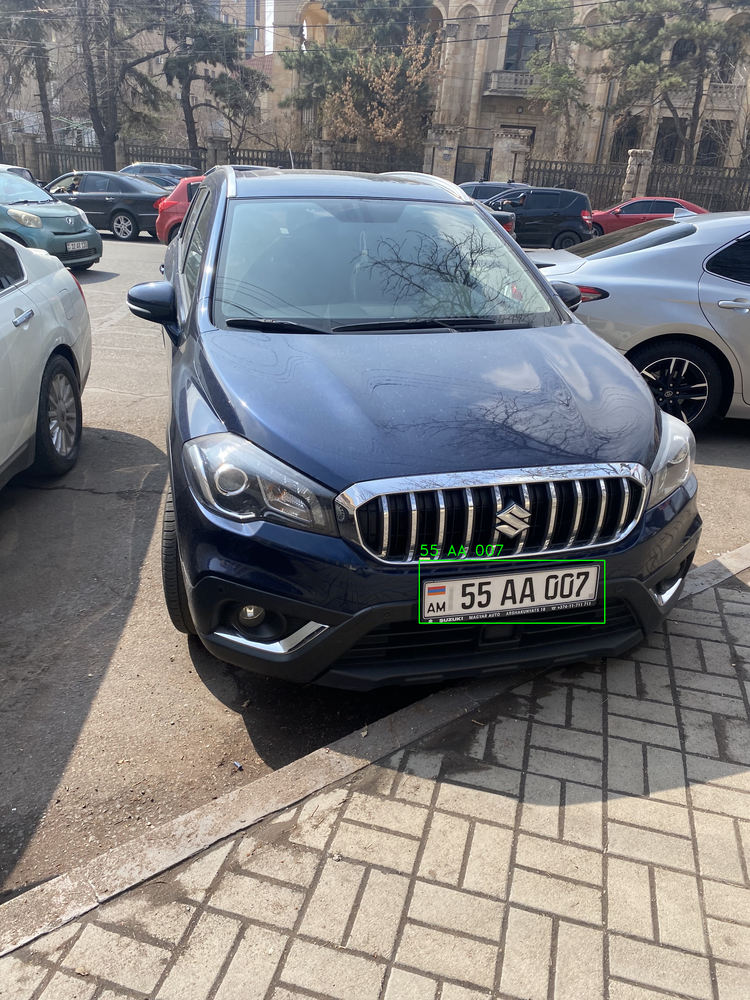

In [ ]:
weights_path = "/content/drive/MyDrive/yolov7/best.pt"
source_path = "/content/drive/MyDrive/yolov7/data/images/D1.jpeg"

lp_recognition(weights_path, source_path)

# Video recognition

In [ ]:
def lp_detect_vid(source_path, weights_path):
    """
    Detects license plate(s) in a video using YOLO object detection algorithm.

    Args:
        source_path (str): Path to the video file to be processed.
        weights_path (str): Path to the pre-trained YOLO weights file.

    Returns:
        None
    """
    # detecting license plate using YOLO
    command = "python detect.py --weights {} --source {} --save-txt".format(
        weights_path, source_path
    )
    os.system(command)

    # getting the image name
    filename = os.path.basename(source_path)
    image_name, _ = os.path.splitext(filename)

    # getting the path to the detected image
    detect_dir = "runs/detect"
    exp_dirs = [
        os.path.join(detect_dir, d)
        for d in os.listdir(detect_dir)
        if d.startswith("exp") and d[3:].isdigit()
    ]
    latest_exp_dir = sorted(exp_dirs, reverse=True)[0]
    img_path = "{}/{}.jpeg".format(latest_exp_dir, image_name)

In [ ]:
source_path = "/content/drive/MyDrive/licenseplate.mp4"
weights_path = "/content/drive/MyDrive/yolov7/best.pt"
lp_detect_vid(source_path, weights_path)

In [ ]:
def extract_frames(input_path, frame_dir, label_file_number):
    """
    Extracts frames from the input video file and saves them as JPEG images in the specified output directory.

    Args:
    input_path (str): Path to the input video file.
    frame_dir (str): Path to the directory where frames will be saved.
    label_file_number (int): The number of the last label file for the
                              video saved in the detected exp folder of YOLO.

    Returns:
    None
    """
    # Create the output directory if it doesn't already exist
    if not os.path.exists(frame_dir):
        os.makedirs(frame_dir)
        print("Output Directory does not exist, creating directory in specified location")
    if os.listdir(frame_dir):
        raise ValueError("Output Directory is NOT empty")

    # Open the video file for reading
    cap = cv2.VideoCapture(input_path)

    # Get the total number of frames in the video
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the frame interval for extracting frames
    frame_interval = int(total_frames / label_file_number)

    # Initialize a counter for the extracted frames
    frame_count = 1

    # Loop through the frames and extract every 'frame_interval' frames
    while cap.isOpened():
        ret, frame = cap.read()

        if not ret:
            break

        # Save the current frame as an image file
        output_path = os.path.join(frame_dir, f"frame_{frame_count}.jpg")
        cv2.imwrite(output_path, frame)

        frame_count += 1

        if frame_count == total_frames:
            break

    # Release the video file and close all windows
    cap.release()

In [ ]:
input_path = "/content/drive/MyDrive/licenseplate.mp4"
frame_dir = "/content/drive/MyDrive/yolov7/runs/detect/exp62/frames"
label_file_number = 350
extract_frames(input_path, frame_dir, label_file_number)

In [ ]:
def lp_recog_vid(filename, label_file, output_dir):
    """
    Recognizes the license plate in the input image of the video frames.

    filename (str): The input image filename.
    label_file (str): The label file containing the license plate bounding box coordinates.
    output_dir (str): The directory to write the output image to.
    Returns:
      The recognized license plate text.
    """
    if not os.path.exists(filename):
        raise FileNotFoundError(f"File not found at path: {filename}")
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        print("Output Directory does not exist, creating directory in specified location")
    # Load the input image
    img = cv2.imread(filename)
    if os.path.exists(label_file):
        with open(label_file, "r") as f:
            line = f.readline().strip().split()
            cls, x, y, w, h = [float(x) for x in line]

        # Get image dimensions
        height, width, _ = img.shape

        # Convert bounding box coordinates from relative to absolute
        a1 = int((x - w / 2) * width)
        b1 = int((y - h / 2) * height)
        a2 = int((x + w / 2) * width)
        b2 = int((y + h / 2) * height)

        # Crop image using the bounding box coordinates
        cropped_img = img[b1:b2, a1:a2]

        # Convert the image to grayscale
        gray = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)

        # Apply Canny edge detection
        edges = cv2.Canny(gray, 100, 200)

        # Apply Hough Line Transform
        lines = cv2.HoughLinesP(
            edges,
            rho=1,
            theta=np.pi / 180,
            threshold=100,
            minLineLength=100,
            maxLineGap=10,
        )

        # Draw the detected lines on a copy of the original image
        line_img = np.zeros_like(cropped_img)
        if lines is not None:
            angles = []
            for line in lines:
                x1, y1, x2, y2 = line[0]
                cv2.line(line_img, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Find the angle of the dominant line
                angle = np.arctan2(y2 - y1, x2 - x1) * 180 / np.pi
                angles.append(angle)

            dominant_angle = np.median(angles)

            # Rotate the image to correct the orientation
            h, w = cropped_img.shape[:2]
            center = (w // 2, h // 2)
            M = cv2.getRotationMatrix2D(center, dominant_angle, 1.0)
            rotated_img = cv2.warpAffine(
                cropped_img,
                M,
                (w, h),
                flags=cv2.INTER_CUBIC,
                borderMode=cv2.BORDER_REPLICATE,
            )

        # Convert the image to grayscale
        if "rotated_img" in locals():
            gray = cv2.cvtColor(rotated_img, cv2.COLOR_BGR2GRAY)
        else:
            gray = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)
        # Apply a Gaussian blur to the grayscale image
        blur = cv2.GaussianBlur(gray, (5, 5), 0)

        # Apply Canny edge detection to the blurred image
        edges = cv2.Canny(blur, 50, 200)

        # Apply adaptive thresholding to create a binary image
        # preprocessed_plate = cv2.adaptiveThreshold(
        #     gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2
        # )

        # Find contours in the edges image
        contours, _ = cv2.findContours(
            edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

        if "rotated_img" in locals():
            plate_img = rotated_img
        else:
            plate_img = cropped_img

        # Use Easy OCR to recognize the license plate number
        # Set language to English
        reader = easyocr.Reader(["en"])

        result = reader.readtext(plate_img)
        if len(result) > 1:
            if len(result[0]) > 1:
                countrycode = result[0][1]
                plate_text = result[1][1].replace(" ", "")

            if len(result[1]) > 1:
                plate_text = result[1][1].replace(" ", "")

        elif len(result) == 1:
            plate_text = result[0][1].replace(" ", "")

        else:
            plate_text = ""
        print(plate_text)

        # Draw the bounding box and license plate number on the image

        if plate_text != "":
            platedetectedimg = cv2.putText(
                img,
                plate_text,
                (a1, b1 - 20),
                cv2.FONT_HERSHEY_DUPLEX,
                2,
                (0, 255, 0),
                thickness=2,
            )
            cv2.rectangle(
                img, (a1, b1), (a2, b2), (0, 255, 0), thickness=4
            )  # Green bounding box
        else:
            platedetectedimg = img
        if not os.path.exists(output_dir):
            os.makedirs(output_dir)
        num_files = len(os.listdir(output_dir))
        outputname = f"{num_files+1}.jpg"

        # Save the image to the output directory
        output_path = os.path.join(output_dir, outputname)
        print(output_path)
        cv2.imwrite(output_path, platedetectedimg)
    else:
        # Check if the output directory exists, if not create it
        if not os.path.exists(output_dir):
            os.makedirs(output_dir)

        # Get the number of files in the output directory and set the output
        # filename
        num_files = len(os.listdir(output_dir))

        # Create the full output path by joining the output directory and
        # filename
        outputname = f"{num_files+1}.jpg"
        output_path = os.path.join(output_dir, outputname)
        cv2.imwrite(output_path, img)

In [ ]:
def process_license_plate_video(
        video_path,
        frames_path,
        output_path,
        output_dir,
        label_path):
    """
    Process a license plate video to recognize license plates in each frame and create an output video.

    Args:
        video_path (str): Path to the input video file.
        frames_path (str): Path to the directory where the input video frames will be saved.
        output_path (str): Path to the output video file.
        output_dir (str): Path to the directory where the recognized license plate frames will be saved.

    Returns:
        None
    """
    # Check if the output directory is empty, raise an error if not
    if os.listdir(output_dir):
        raise ValueError("Output Directory is NOT empty")

    # Check if the video file exists, raise an error if not
    if not os.path.exists(video_path):
        raise FileNotFoundError(f"Video file not found at path: {video_path}")

    # Check if the frames directory exists, raise an error if not
    if not os.path.exists(frames_path):
        raise FileNotFoundError(f"Folder not found at path: {frames_path}")

    # Check if the label directory exists, raise an error if not
    if not os.path.exists(label_path):
        raise FileNotFoundError(f"Folder not found at path: {label_path}")

    # Open the input video file for reading
    video_capture = cv2.VideoCapture(video_path)

    # Count the total number of label files in the 'labels' directory
    total_labels = len(os.listdir(label_path))

    # Initialize a variable to count the processed frames
    frame_count = 1

    # Loop over the video frames until all the label files are processed or
    # the video ends
    count = 0
    while video_capture.isOpened():
        # read a frame from the video
        success, image = video_capture.read()  
        if not success:  # if the frame reading fails, break the loop
            break
        
        # set the video position to the next 1/5th frame (as the label file is created after 5 frames)
        count += video_capture.get(cv2.CAP_PROP_FPS) // 5
        video_capture.set(cv2.CAP_PROP_POS_FRAMES, count)
        
        # create a label file path for the current frame and an image filename
        label_file = os.path.join(
            label_path, f"licenseplate_{frame_count}.txt")
        filename = os.path.join(frames_path, f"frame_{frame_count}.jpg")

        # save the current frame as an image
        cv2.imwrite(filename, image)
        
        # recognize the license plate(s) in the saved frame(s)
        lp_recog_vid(filename, label_file, output_dir)

        # move to the next 1/5th frame
        frame_count += 5

    # release the video capture object
    video_capture.release()

    # Get the list of image filenames in the frames directory
    img_files = os.listdir(output_dir)

    # Get the size of the first image to use as the size of the output video
    first_img = cv2.imread(os.path.join(output_dir, img_files[0]))
    video_size = (first_img.shape[1], first_img.shape[0])

    # Create a VideoWriter object to write the output video
    fourcc = cv2.VideoWriter_fourcc(*"mp4v")
    output_video = cv2.VideoWriter(output_path, fourcc, 6, video_size)

    # Loop over the image filenames in the frames directory and write each
    # image to the output video
    for img_file in img_files:
        img_path = os.path.join(output_dir, img_file)
        img = cv2.imread(img_path)
        output_video.write(img)
        time.sleep(0.1)
    #release the VideoWriter object
    output_video.release()

In [ ]:
video_path = "/content/drive/MyDrive/licenseplate.mp4"
frames_path = "/content/drive/MyDrive/yolov7/runs/detect/exp62/frames"
output_path = "/content/drive/MyDrive/yolov7/runs/detect/exp62/output4.mp4"
output_dir = "/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4"
label_path = "/content/drive/MyDrive/yolov7/runs/detect/exp62/labels"

process_license_plate_video(
    video_path,
    frames_path,
    output_path,
    output_dir,
    label_path)


36AU937
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/1.jpg
B6AU932/
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/2.jpg
B6AU937
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/3.jpg
36AU937
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/4.jpg
36AU237
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/5.jpg
36AU97
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/6.jpg
36AU?
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/7.jpg
36
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/8.jpg
10
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/15.jpg
GL110
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/16.jpg
I1GL110
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/17.jpg
11GL110
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/18.jpg
11GL110
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/19.jpg
11GL110
/content/drive/MyDrive/yolov7/runs/detect/exp62/outputs4/20.jpg
11
/content/dr